<a href="https://colab.research.google.com/github/octaviobedregal/maestria/blob/master/DetectObjectsSpineNet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<a href="https://colab.research.google.com/github/open-mmlab/mmdetection/blob/master/demo/MMDet_Tutorial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Detectar objectos de un video/ imagen con MMDetection - Backbone SpineNet y Fpn


**1. Verificar versión de GPU**

In [ ]:
# Check nvcc version
!nvcc -V
# Check GCC version
!gcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Oct_12_20:09:46_PDT_2020
Cuda compilation tools, release 11.1, V11.1.105
Build cuda_11.1.TC455_06.29190527_0
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



**2. Instalar Librerias**

In [ ]:
%cd /content
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.10.0+cu102 torchvision -f https://download.pytorch.org/whl/torch_stable.html

# install mmcv-full thus we could use CUDA operators
!pip install mmcv-full -f https://download.openmmlab.com/mmcv/dist/cu102/torch1.10.0/index.html

# Install mmdetection
!rm -rf mmdetection
!git clone https://github.com/open-mmlab/mmdetection.git

%cd mmdetection
#!git checkout 8732ed9
!pip install -v -e .

/content
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |██████████████████████████████▎ | 834.1 MB 1.2 MB/s eta 0:00:40tcmalloc: large alloc 1147494400 bytes == 0x5585189b8000 @  0x7f331f00b615 0x5584de7244cc 0x5584de80447a 0x5584de7272ed 0x5584de818e1d 0x5584de79ae99 0x5584de7959ee 0x5584de728bda 0x5584de79ad00 0x5584de7959ee 0x5584de728bda 0x5584de797737 0x5584de819c66 0x5584de796daf 0x5584de819c66 0x5584de796daf 0x5584de819c66 0x5584de796daf 0x5584de729039 0x5584de76c409 0x5584de727c52 0x5584de79ac25 0x5584de7959ee 0x5584de728bda 0x5584de797737 0x5584de7959ee 0x5584de728bda 0x5584de796915 0x5584de728afa 0x5584de796c0d 0x5584de7959ee
     |████████████████████████████████| 881.9 MB 19 kB/s 
     |████████████████████████████████| 66.9 MB 188 kB/s 
     |████████████████████████████████| 66.7 MB 92 kB/s 
     |████████████████████████████████| 24.5 MB 677 kB/s 
     |████████████████████████████████| 24.5 MB 1.3 MB/s 
     |████████████████████████████████|

**3. Verificar instalación y versiones de las librerias instaladas**



In [ ]:
# Check Pytorch installation
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

# Check MMDetection installation
import mmdet
print(mmdet.__version__)

# Check mmcv installation
from mmcv.ops import get_compiling_cuda_version, get_compiler_version
print(get_compiling_cuda_version())
print(get_compiler_version())

1.10.0+cu102 True
2.20.0
10.2
GCC 7.3


**4. Descargar el proyecto de SpineNet y copiar sus configuraciones en el proyecto de mmdetection**

In [ ]:
#Ejecutar este punto solo si se usa el modelo de SpineNet
%cd /content
!git clone https://github.com/yan-roo/SpineNet-Pytorch.git
!cp -r SpineNet-Pytorch/mmdet/ mmdetection/
!cp -r SpineNet-Pytorch/configs/ mmdetection/

/content
Cloning into 'SpineNet-Pytorch'...
remote: Enumerating objects: 176, done.
remote: Counting objects: 100% (176/176), done.
remote: Compressing objects: 100% (101/101), done.
remote: Total 176 (delta 98), reused 120 (delta 60), pack-reused 0
Receiving objects: 100% (176/176), 2.05 MiB | 8.69 MiB/s, done.
Resolving deltas: 100% (98/98), done.


**5. Descargar modelo entrenado de mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco**

In [ ]:
%cd /content/mmdetection
!mkdir checkpoints
!wget -c https://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth \
      -O checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth

/content/mmdetection
--2022-01-28 00:17:55--  https://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 47.75.20.18
Connecting to download.openmmlab.com (download.openmmlab.com)|47.75.20.18|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 177867103 (170M) [application/octet-stream]
Saving to: ‘checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth’

checkpoints/mask_rc 100%[===================>] 169.63M  11.4MB/s    in 15s     

2022-01-28 00:18:10 (11.5 MB/s) - ‘checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth’ saved [177867103/177867103]



**6. Crear modelo con el archivo .pth y de configuración**

In [ ]:
%cd /content/mmdetection/

from mmdet.apis import inference_detector, init_detector, show_result_pyplot

#OPCIÓN 1
#RetinaNet-SpineNet
# Choose to use a config and initialize the detector
#config = 'configs/spinenet/spinenet_49S_B_8gpu.py'
# Setup a checkpoint file to load
#checkpoint = '/content/spinenet_49S-34005c35.pth'

#OPCIÓN 2
#Mask-Rcnn-Fpn
# Choose to use a config and initialize the detector
config = 'configs/mask_rcnn/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco.py'
# Setup a checkpoint file to load
checkpoint = 'checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth'

# initialize the detector
model = init_detector(config, checkpoint, device='cuda:0')

/content/mmdetection
load checkpoint from local path: checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth


***7. Ejecutar detección de objetos de una imagen***

/content/mmdetection/mmdet/datasets/utils.py:69: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  'data pipeline in your config file.', UserWarning)


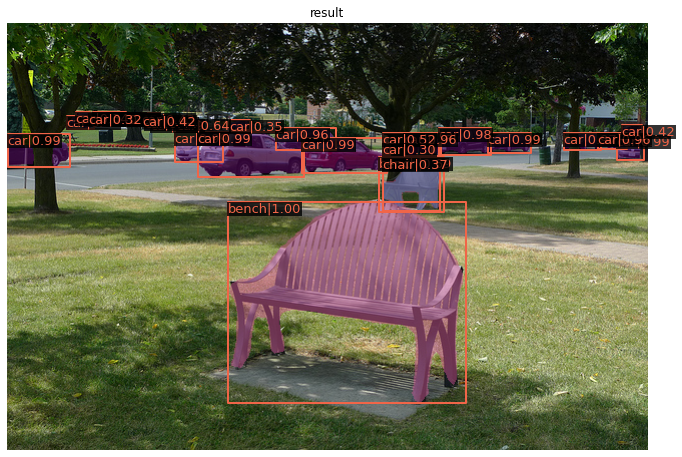

In [ ]:
# Use the detector to do inference
img = '/content/mmdetection/demo/demo.jpg'
result = inference_detector(model, img)
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.3)

***8. Ejecutar detección de objetos de un video***

/content/mmdetection
rm: cannot remove '/content/mmdetection/demo/out_images': No such file or directory
rm: cannot remove '/content/mmdetection/demo/out_video': No such file or directory


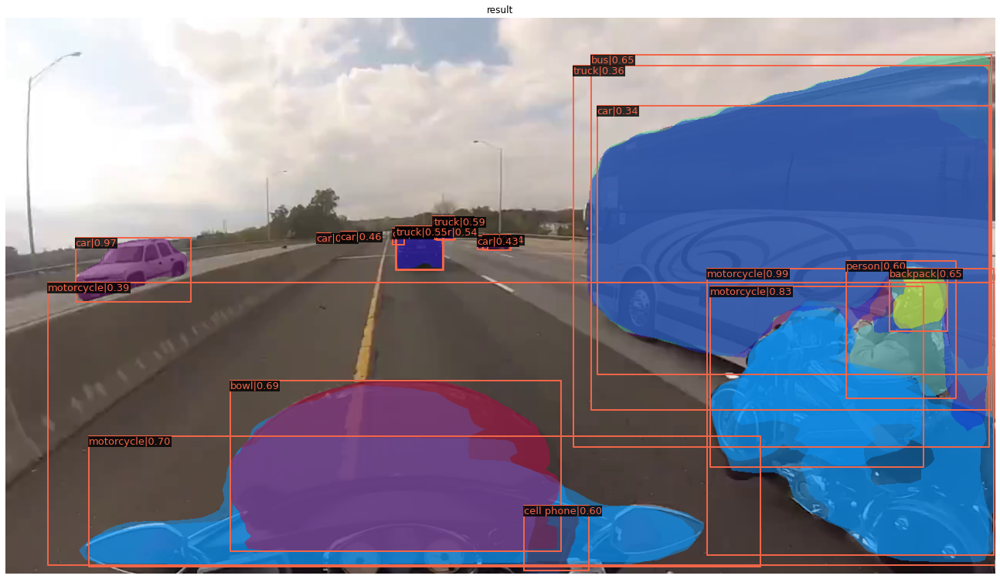

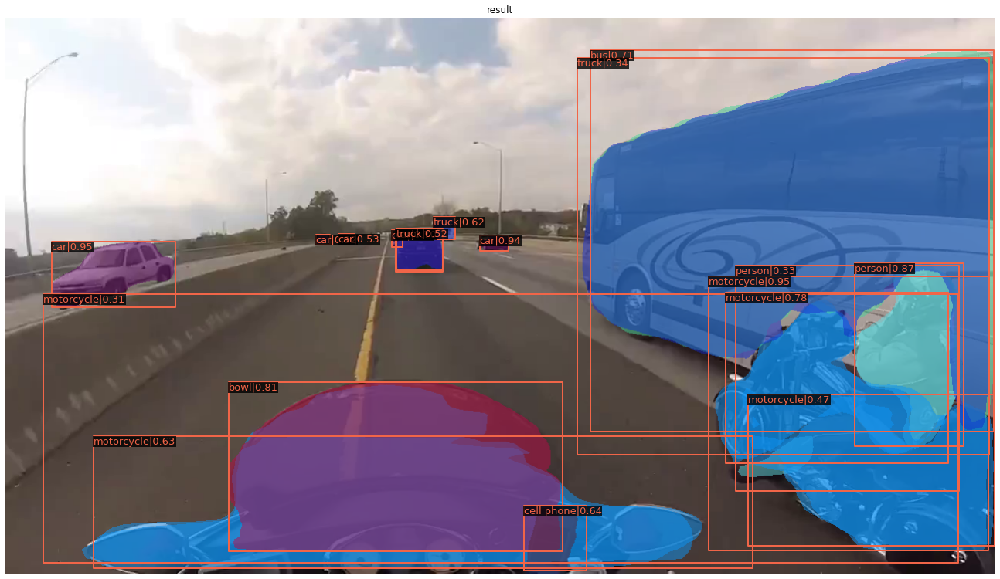

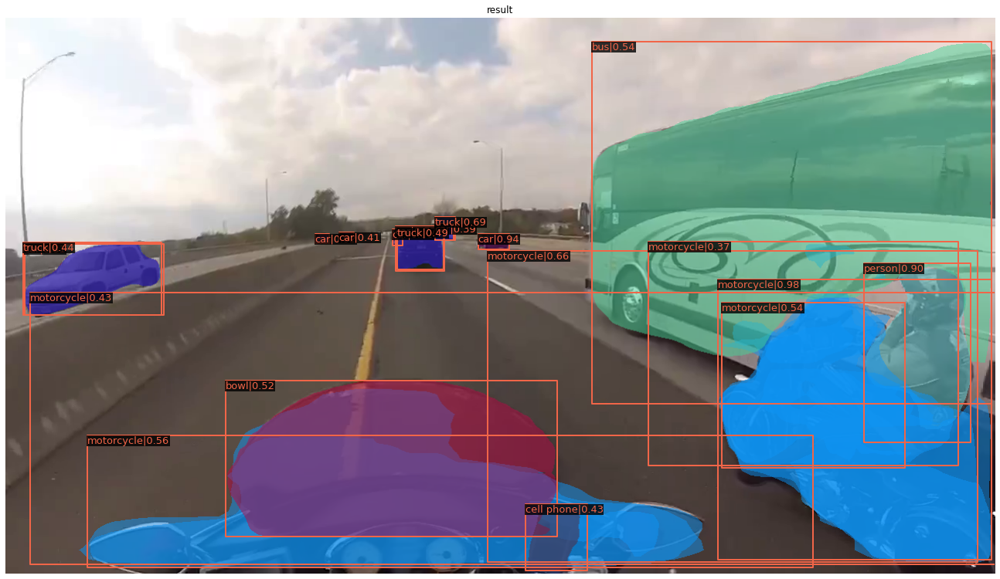

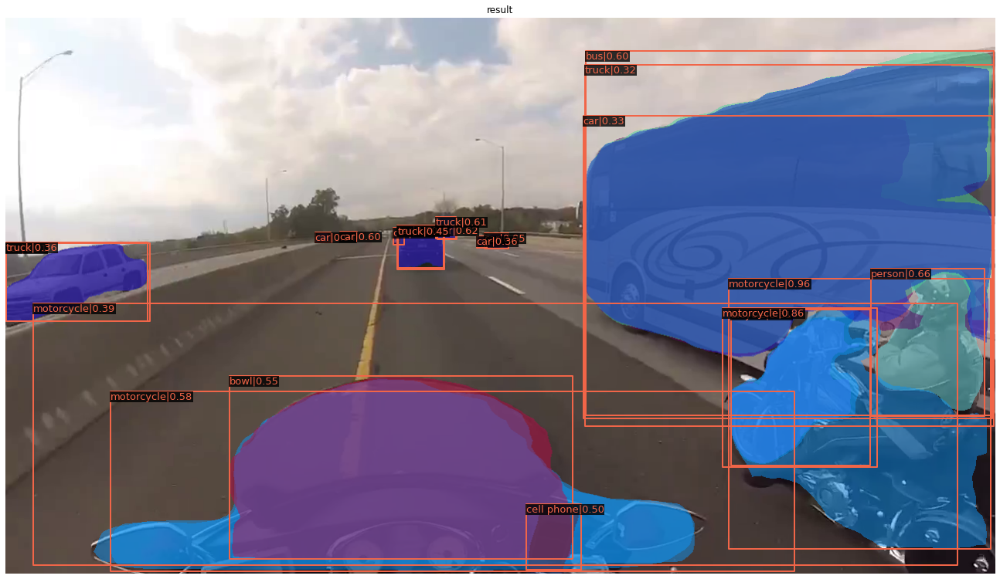

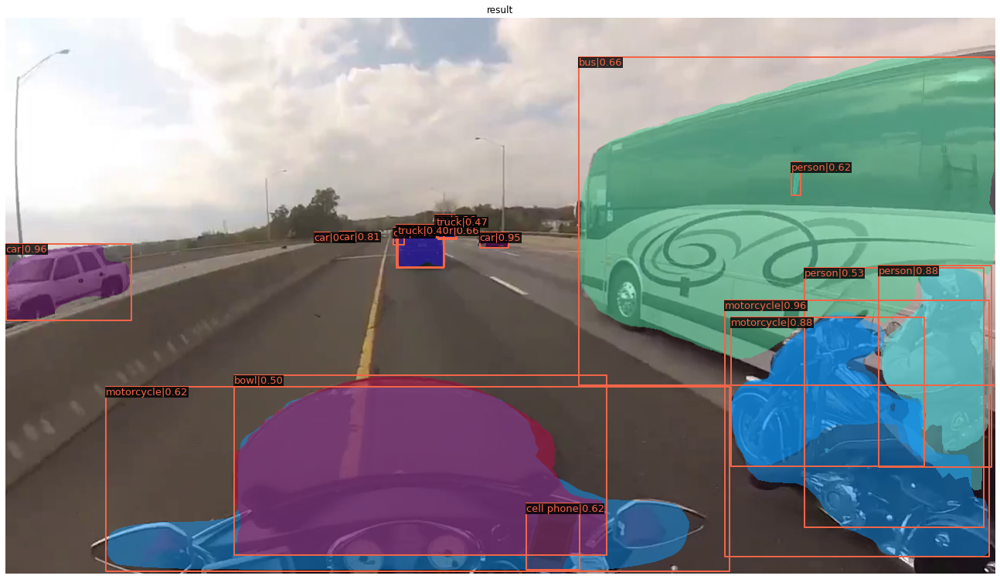

...

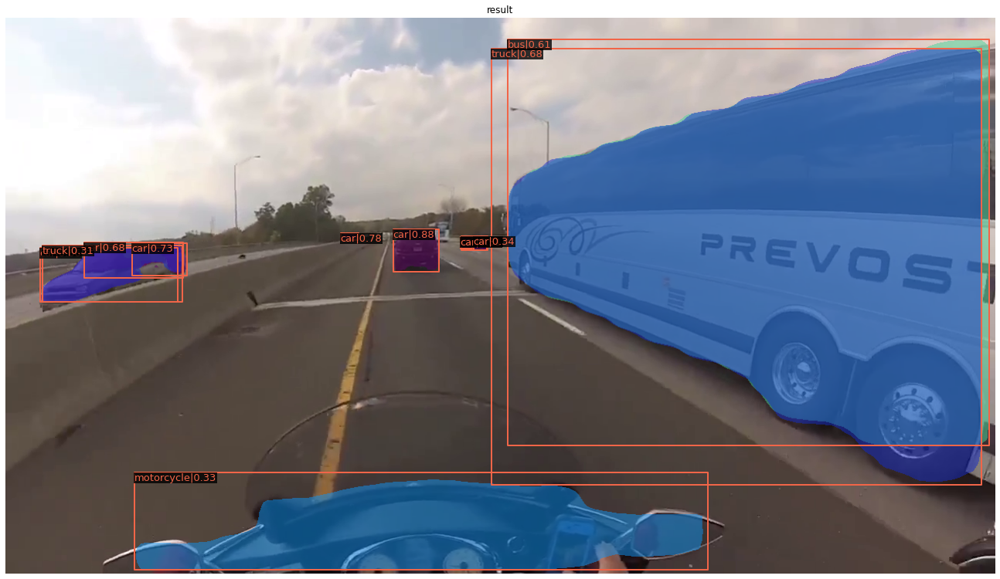

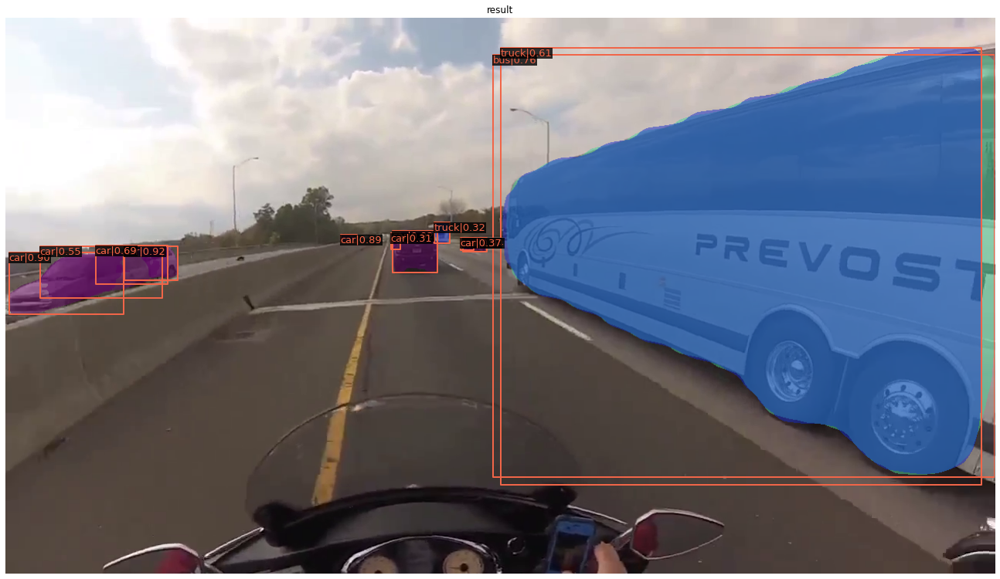

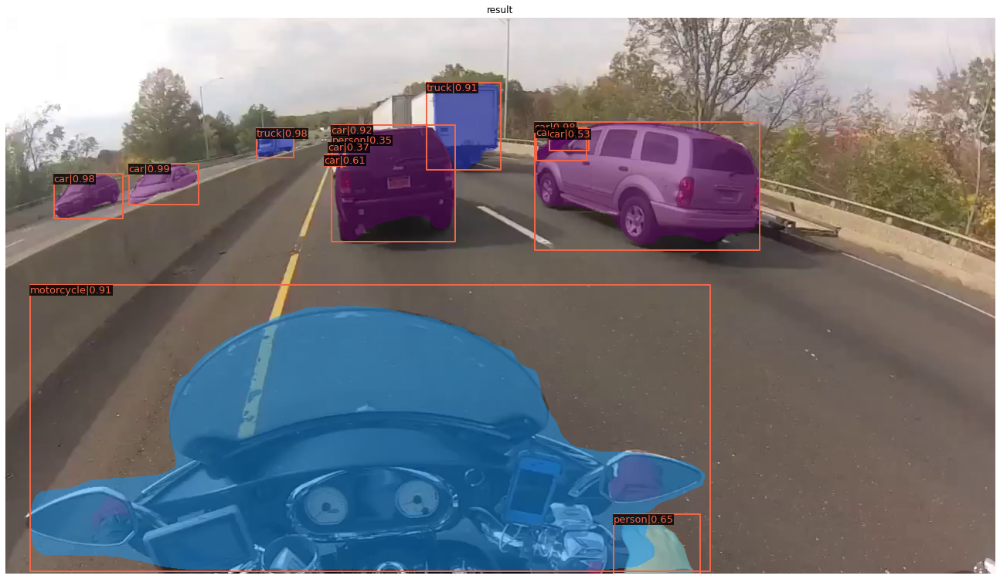

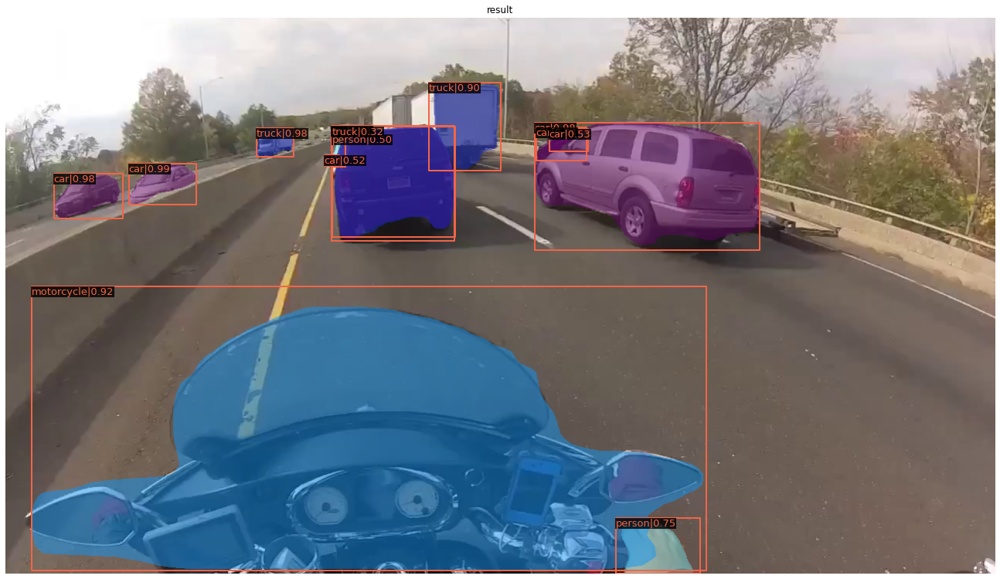

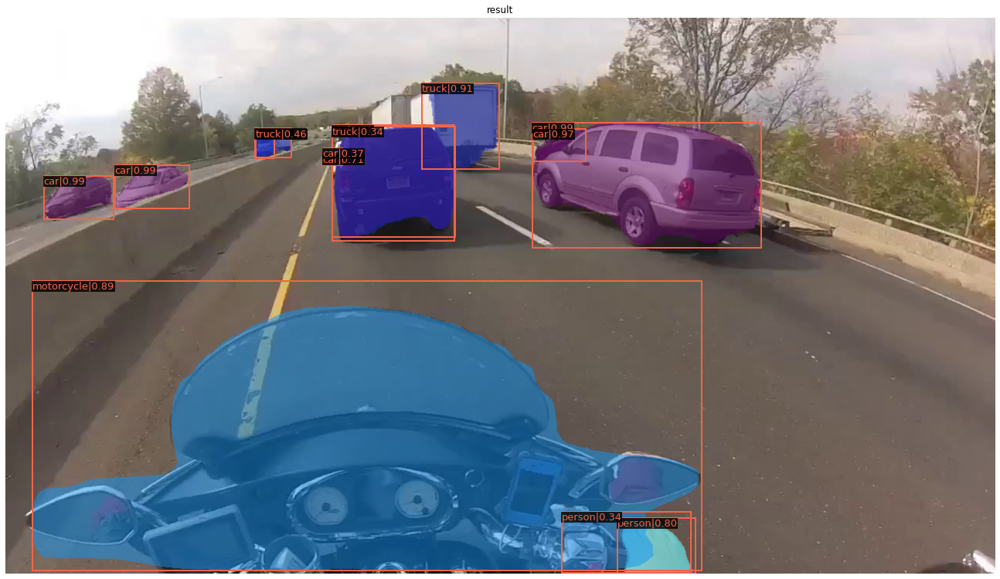

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 67/67, 32.5 task/s, elapsed: 2s, ETA:     0s


In [ ]:
import mmcv
%cd /content/mmdetection/
video = mmcv.VideoReader('/content/mmdetection/demo/demo.mp4')

!rm -r '/content/mmdetection/demo/out_images'
!rm -r '/content/mmdetection/demo/out_video'

!mkdir '/content/mmdetection/demo/out_images'
!mkdir '/content/mmdetection/demo/out_video'
cont = 0
for frame in video:
    result = inference_detector(model, frame)
    # Muestra la detección de objectos del frame
    show_result_pyplot(model, frame, result, wait_time=1)    
    nameFile = str(cont).zfill(6) + '.jpg'
    # Guarda la detección de objectos del frame en un directorio
    model.show_result(frame, result, out_file='/content/mmdetection/demo/out_images/'+ nameFile, wait_time = 2)
    cont = cont + 1

mmcv.frames2video('/content/mmdetection/demo/out_images', '/content/mmdetection/demo/out_video/demo_object_detected.mp4') 